In [33]:
import os 
import sys
from pathlib import Path

import numpy as np

import matplotlib
import matplotlib.pyplot as plt
from tqdm.notebook import trange, tqdm
import scanpy as sc
import anndata as ad
import h5py 
from skimage.transform import rescale, resize
from skimage import color

from matplotlib.pyplot import rc_context
sc.settings.verbosity = 3
import seaborn as sns

In [34]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / 'data'

In [35]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Read images

In [36]:
import umap
from skimage import metrics
import numpy as np
import scipy.io
from sklearn.preprocessing import MinMaxScaler, StandardScaler

h5_data_dir = p_dir / 'data' / 'h5'

def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)

def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f'{experiment}.hdf5', 'r') as f:
        imgs = f[name][:]
        labels = list(f[name].attrs['labels'])
        fov = f[name].attrs['fov']
        
    return imgs, labels, fov

def get_imgs_index(imgs, index_list):
    
    imgs_subset = imgs[index_list, :,:]
    img_combined = np.sum(imgs_subset, axis=0)
    return img_combined

def get_mass(file):
    labels=['Total', 'Rest']
    with open(file) as infile:
        next(infile)
        for line in infile:
            mass = float(line.split("\t")[1])
            mass = np.round(mass, 1)
            labels.append(mass)
    return labels

def normalize(imgs, labels, dataset):
    data_all = imgs.reshape(-1, imgs.shape[1]*imgs.shape[1]).transpose()
    data_all_norm = (data_all+1)/(np.percentile(data_all,50,axis=1,keepdims=True)+1)
    data_all_norm = np.log(data_all_norm + 1)
    
    # Transform to annadata type
    adata = ad.AnnData(data_all_norm, dtype=data_all_norm.dtype)
    adata.var_names = np.array(labels).astype(str)
    adata.obs['Dataset'] = dataset
    sc.pp.scale(adata)
    return adata

def umap_transform(adata):
    sc.tl.pca(adata)
    sc.pp.neighbors(adata, metric='cosine')
    sc.tl.umap(adata,n_components=3)
    embedding = adata.obsm['X_umap']
    
    # Transform feature range
    fg_umap_norm = MinMaxScaler().fit_transform(embedding)
    fg_umap_norm[:,0] = MinMaxScaler(feature_range=(0, 100)).fit_transform(fg_umap_norm[:,0][:,None])[:,0]
    fg_umap_norm[:,1] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(fg_umap_norm[:,1][:,None])[:,0]
    fg_umap_norm[:,2] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(fg_umap_norm[:,2][:,None])[:,0]
    
    adata.obsm['X_umap'] = fg_umap_norm

def corr_images(im1, im2):
    im1 = im1.astype("float")
    im2 = im2.astype("float")

    # get rid of the averages, otherwise the results are not good
    im1 -= np.mean(im1)
    im2 -= np.mean(im2)

    # calculate the correlation image; note the flipping of onw of the images
    return np.corrcoef(im1.reshape(-1), im2.reshape(-1))    
    
def get_corr(imgs, img_template, n=6):
    # Get correlation between images
    corrs = []
    for i, img in enumerate(imgs):
        # Pass 0 correlation for total and sum images
        if i in [0, 1]:
            corrs.append(0)
            continue
        corr = corr_images(img_template, img)
        corrs.append(corr[1, 0])

    # Get top similar images
    top_similar = np.argsort(corrs)[-n:][::-1]
    return top_similar, corrs

In [37]:
# masses = get_mass(data_dir / 'metadata' / 'peak.TXT')

In [38]:
masses = ['Total', 'Rest', 1.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.7, 21.7, 22.6, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 84.0, 85.0, 86.0, 87.0, 88.0, 89.0, 90.0, 91.0, 92.0, 93.0, 94.0, 95.0, 96.0, 97.0, 98.0, 99.0, 100.0, 101.0, 102.0, 103.0, 104.0, 105.0, 106.0, 107.0, 108.0, 109.0, 110.0, 111.0, 112.0, 113.0, 114.0, 115.0, 116.0, 117.0, 118.0, 119.0, 120.0, 121.0, 122.0, 123.0, 124.0, 125.0, 126.0, 127.0, 128.0, 129.0, 130.0, 131.0, 132.0, 133.0, 134.0, 135.0, 136.0, 137.0, 138.0, 139.0, 140.0, 141.0, 142.0, 143.0, 144.0, 145.0, 146.0, 147.0, 148.0, 149.0, 150.0, 151.0, 152.0, 153.0, 154.0, 155.0, 156.0, 157.0, 158.0, 159.0, 160.0, 161.0, 162.0, 163.0, 164.0, 165.0, 166.0, 167.0, 168.0, 169.0, 170.0, 171.0, 172.0, 173.0, 174.0, 175.0, 176.0, 177.0, 178.0, 179.0, 181.0, 182.0, 183.0, 184.9, 186.0, 187.0, 188.0, 189.0, 192.0, 193.9, 195.9, 197.0, 198.9, 200.9, 204.9, 208.9, 210.0, 216.9, 221.9, 228.9, 233.9, 237.9, 242.9, 253.3, 277.0, 325.2, 328.9, 343.8]

In [39]:
experiment = 'Lung'

ts_data_dir = p_dir / 'data' / 'tof-sims' / experiment
images_dir = p_dir / 'figures' / 'surface_plot'

datasets = os.listdir(ts_data_dir)
datasets = [dataset for dataset in datasets if 'auto' in dataset]

In [40]:
m_start = 0
mz_sets = set()
for dataset in datasets:
    # Read images and get PO3 channel
    print(dataset)
    imgs, labels, fov = get_imgs(experiment, dataset)
    
    img_po3 = get_imgs_index(imgs[m_start:], [70-m_start])
    top_similar, corrs = get_corr(imgs, img_po3, n=25)  # Get correlation
    
    top_similar = sorted(top_similar)
    mz_sets.update(top_similar)
    
mz_sets = np.array(sorted(mz_sets)) + m_start
mz_sets = mz_sets[mz_sets < 100]

auto_B5_1
auto_B5_2
auto_B5_3
auto_C6_1
auto_C6_2
auto_C6_3
auto_C6_4
auto_D4_1
auto_D4_2
auto_D4_3
auto_E4_1
auto_E4_2
auto_E4_3
auto_E4_4
auto_E6_1
auto_E6_2
auto_E6_3
auto_F4_1
auto_F4_2
auto_F4_3
auto_F7_1
auto_F7_2
auto_F7_3
auto_F7_4


In [41]:
mz_sets

array([ 2,  4,  7,  8, 16, 17, 22, 26, 31, 32, 33, 34, 38, 41, 46, 54, 55,
       56, 57, 58, 62, 66, 69, 70, 71, 72, 75, 78, 80, 81, 82, 83, 84, 88,
       91, 93, 94, 98], dtype=int64)

In [42]:
adatas = []
for dataset in datasets:
    # Read images and get PO3 channel
    print(dataset)
    imgs, labels, fov = get_imgs(experiment, dataset)
    shape = imgs[0].shape[0]
    fov = int(fov)
    assert len(labels) == len(masses)
    
    # Get pixels from reshaped image
    imgs_stack = imgs[mz_sets,:,:]
    imgs_stack = resize(imgs_stack, (imgs_stack.shape[0], fov, fov), anti_aliasing=False, preserve_range=True)
    
    adata_subset = normalize(imgs_stack, np.array(masses)[mz_sets], dataset)
    # Append to adatas
    adatas.append(adata_subset)
    print(adata_subset.X.shape)
    
adata = ad.concat(adatas)

auto_B5_1
(123201, 38)
auto_B5_2
(123201, 38)
auto_B5_3
(123201, 38)
auto_C6_1
(112225, 38)
auto_C6_2
(112225, 38)
auto_C6_3
(112225, 38)
auto_C6_4
(112225, 38)
auto_D4_1
(112225, 38)
auto_D4_2
(112225, 38)
auto_D4_3
(112225, 38)
auto_E4_1
(123201, 38)
auto_E4_2
(123201, 38)
auto_E4_3
(123201, 38)
auto_E4_4
(126025, 38)
auto_E6_1
(66049, 38)
auto_E6_2
(66049, 38)
auto_E6_3
(66049, 38)
auto_F4_1
(126025, 38)
auto_F4_2
(123201, 38)
auto_F4_3
(123201, 38)
auto_F7_1
(250000, 38)
auto_F7_2
(250000, 38)
auto_F7_3
(64516, 38)
auto_F7_4
(64516, 38)


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [43]:
umap_transform(adata)

computing PCA
    with n_comps=37
    finished (0:00:08)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:06:34)
computing UMAP


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\umap\spectral.py:342: UserWarning: Exited at iteration 20 with accuracies 
[0.00050089 0.00167032 0.01500497 0.02257661]
not reaching the requested tolerance 1e-08.
  eigenvalues, eigenvectors = scipy.sparse.linalg.lobpcg(


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (1:15:14)


auto_B5_1
auto_B5_2
auto_B5_3
auto_C6_1
auto_C6_2
auto_C6_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


auto_C6_4
auto_D4_1
auto_D4_2
auto_D4_3
auto_E4_1
auto_E4_2
auto_E4_3
auto_E4_4
auto_E6_1
auto_E6_2
auto_E6_3
auto_F4_1
auto_F4_2
auto_F4_3
auto_F7_1
auto_F7_2


C:\Users\thu71\AppData\Local\Temp\ipykernel_39580\1619596443.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


auto_F7_3
auto_F7_4


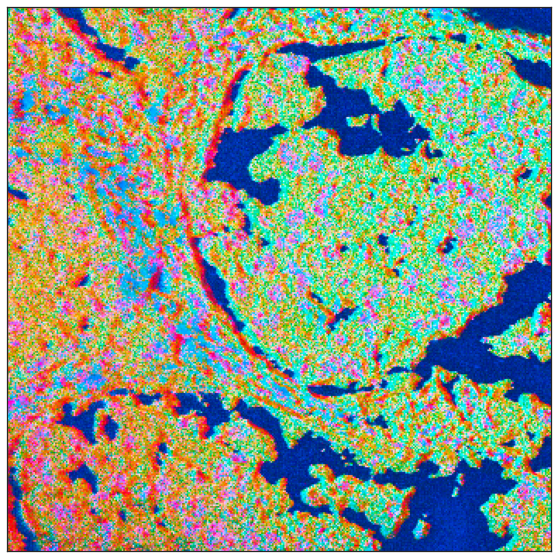

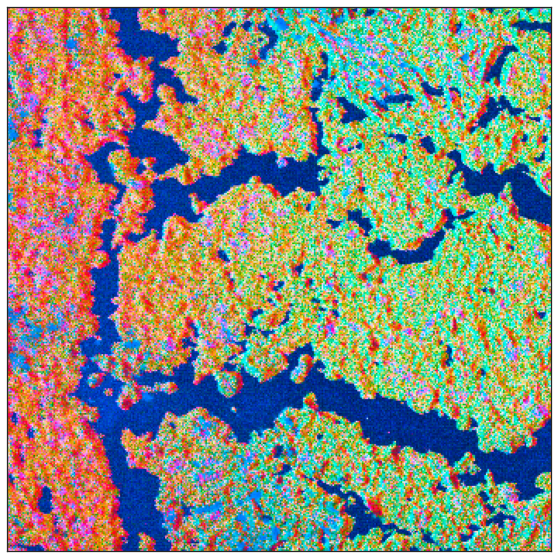

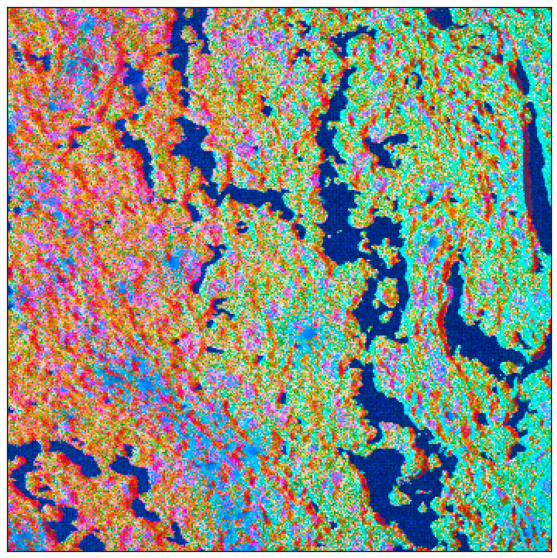

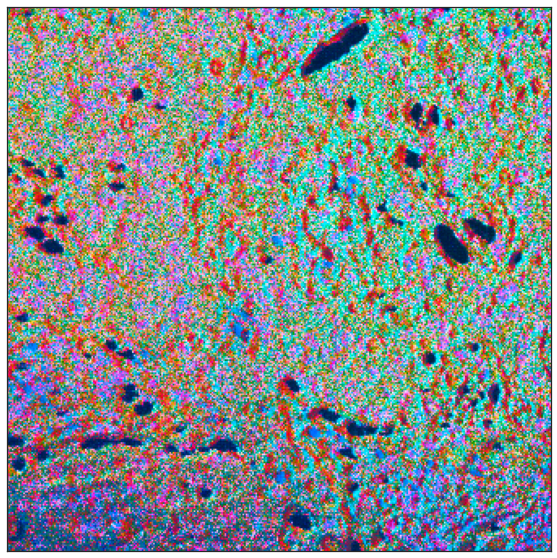

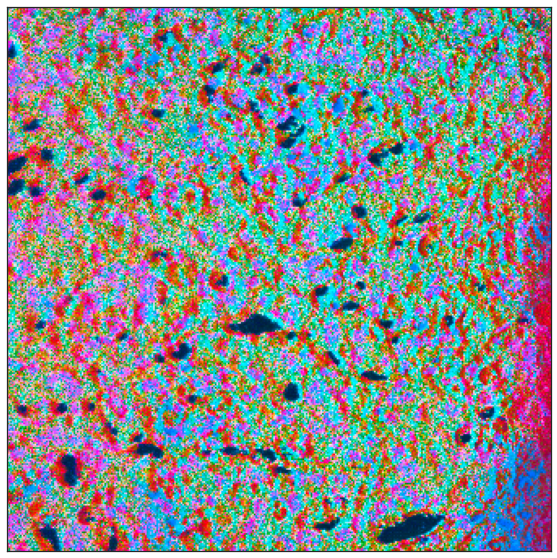

...

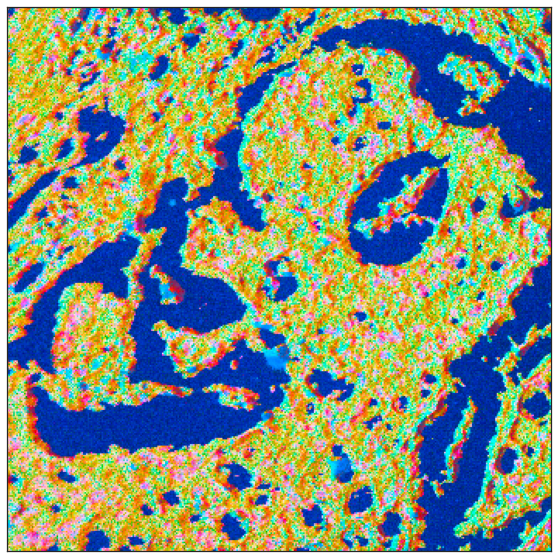

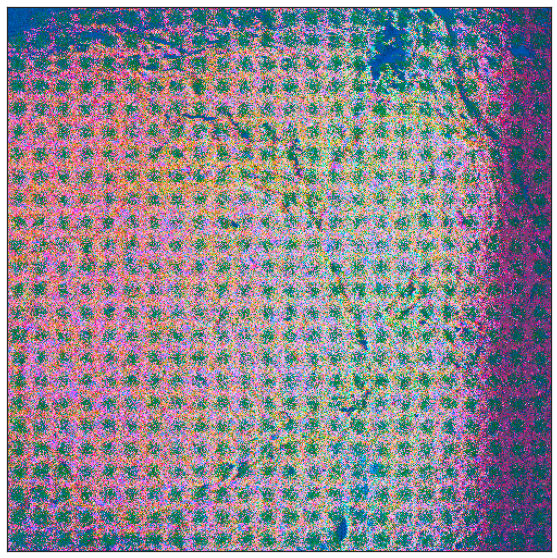

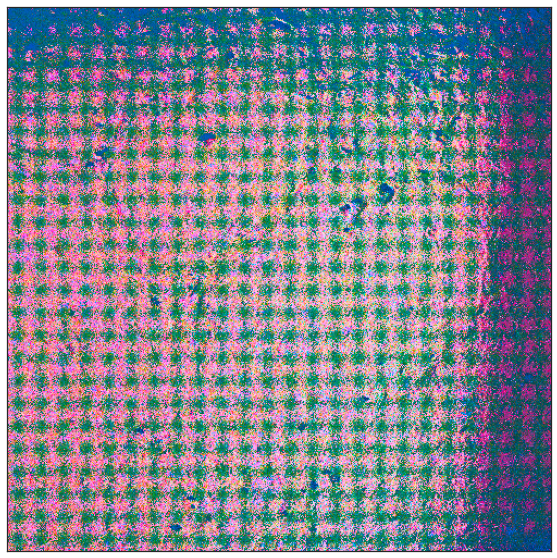

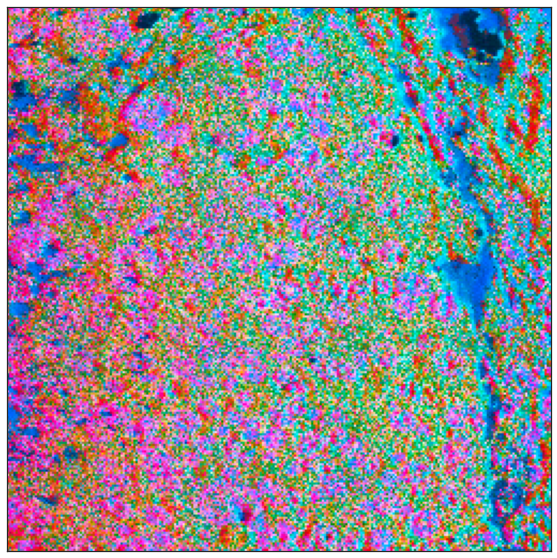

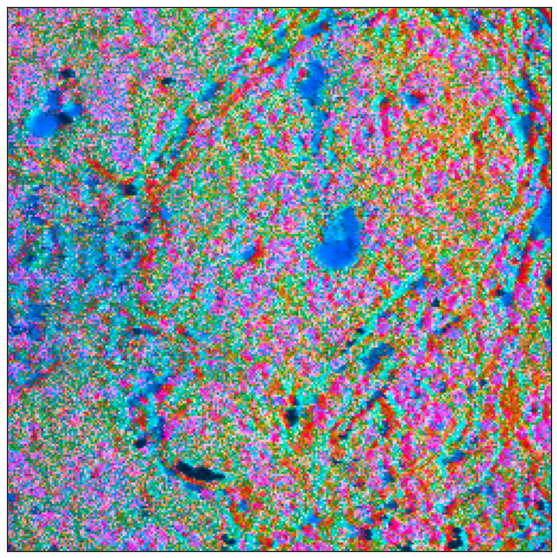

In [44]:
for dataset in datasets:
    print(dataset)
    adata_subset = adata[adata.obs.Dataset == dataset, :]
    fov = int(np.sqrt(len(adata_subset)))
    
    X_umap = adata_subset.obsm['X_umap']
    
    data_rgb_img = X_umap.reshape(fov, fov, 3)
    data_rgb_img = color.lab2rgb(data_rgb_img)
    
    sns.set(style='white')
    plt.figure(figsize=(10,10))
    plt.imshow(data_rgb_img)
    plt.xticks([])
    plt.yticks([])


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


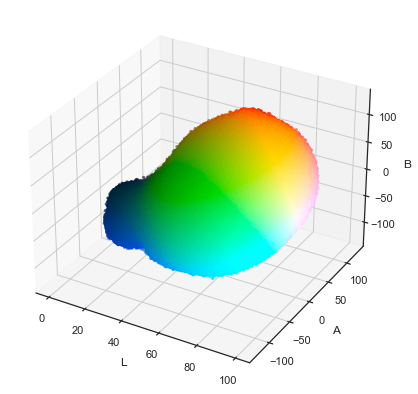

In [45]:
X_umap = adata.obsm['X_umap']
data_rgb = color.lab2rgb(X_umap)

# PLot lab umap
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xs=X_umap[:,0], ys=X_umap[:,1], zs=X_umap[:,2], s=10,  c=data_rgb, lw=0, alpha=0.7)
ax.set_xlabel('L')
ax.set_ylabel('A')
ax.set_zlabel('B')
plt.show()

In [46]:
# path = Path.cwd().parent / 'data' / 'clustering' / f'{experiment}_pixels_umap.h5ad'
# adata.write(path)